In [41]:
import sys
import os
os.chdir("/athena/marchionnilab/scratch/lab_data/Mohamed/pca_TME")
#sys.setrecursionlimit(22000)
from pathlib import Path
import scanpy as sc
from matplotlib.pyplot import ion
import pandas as pd
import scipy.sparse as sp
import loompy as lp
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
from pyscenic.aucell import aucell
from pyscenic.binarization import binarize
from pyscenic.plotting import plot_binarization, plot_rss
from pyscenic.rss import regulon_specificity_scores
from pyscenic.transform import df2regulons
from pyscenic.utils import load_motifs
from pyscenic.export import add_scenic_metadata, export2loom
from matplotlib.pyplot import gcf
import os, glob, re, pickle
from functools import partial
from collections import OrderedDict
from cytoolz import compose
import operator as op
import anndata as ad
sc.settings.figdir = ''

In [42]:
sc._settings.ScanpyConfig(plot_suffix = '', n_jobs = 20, max_memory = 100)
sc.set_figure_params(dpi_save = 300)

In [43]:
def savesvg(fname: str, fig, folder: str) -> None:
    """
    Save figure as vector-based SVG image format.
    """
    fig.tight_layout()
    fig.savefig(os.path.join(folder, fname), format="svg")

############

# Regulons

In [45]:
# load adata_human
adata_human = sc.read_h5ad('outs_human/h5ads/erg_fibroblasts_scvi_v6_regulons.h5ad', chunk_size=100000)

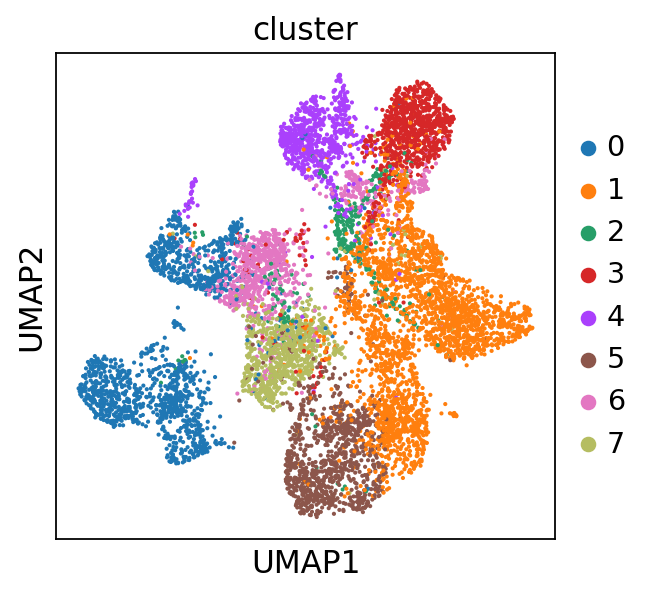

In [46]:
# load mouse data
adata_mouse = sc.read_h5ad('outs/h5ads/fapcm_fibroblasts_v6_clean_regulons_5.h5ad', chunk_size=100000)
adata_mouse.obs['cluster'] = adata_mouse.obs['cluster'].astype('str')
adata_mouse = adata_mouse[adata_mouse.obs['cluster'] != 'nan', :]
# recompute the neighbors for the adata_mouse_terg (ref dataset)
sc.pp.pca(adata_mouse)
sc.pp.neighbors(adata_mouse)
sc.tl.umap(adata_mouse)
sc.pl.umap(adata_mouse, color='cluster')
adata_human.uns['cluster_colors'] = adata_mouse.uns['cluster_colors']  # fix colors

In [47]:
# Ingest
# change the var_names to match mouse gene symbols
adata_human.var_names = [gene.title() for gene in adata_human.var_names]

# subset also the adata_human.raw
tempAdata = adata_human.raw.to_adata()
tempAdata.var_names = [gene.title() for gene in tempAdata.var_names]
adata_human.raw = tempAdata
# find common genes
var_names = adata_mouse.var_names.intersection(adata_human.var_names)
len(var_names)
# subset
adata_mouse = adata_mouse[:, var_names]
adata_human = adata_human[:, var_names]

In [48]:
# divide the human data into ERG pos and neg
adata_human_ERGpos = adata_human[adata_human.obs.erg=='positive']
adata_human_ERGneg = adata_human[adata_human.obs.erg=='negative']

# divide the mouse data based on the T-erg model
adata_mouse_terg = adata_mouse[adata_mouse.obs.key=='terg']
adata_mouse_nonterg = adata_mouse[adata_mouse.obs.key!='terg']

# Ingest using adata_mouse_terg as reference and adata_human_ERGpos as the target
sc.pp.pca(adata_mouse_terg)
sc.pp.neighbors(adata_mouse_terg)
sc.tl.umap(adata_mouse_terg)
sc.tl.ingest(adata_human_ERGpos, adata_mouse_terg, obs='cluster')

# Ingest using adata_mouse_nonterg as reference and adata_human_ERGneg as the target
sc.pp.pca(adata_mouse_nonterg)
sc.pp.neighbors(adata_mouse_nonterg)
sc.tl.umap(adata_mouse_nonterg)
sc.tl.ingest(adata_human_ERGneg, adata_mouse_nonterg, obs='cluster')



In [49]:
# concat adata_human_ERGpos and adata_human_ERGneg into a new adata_human
adata_human_list = [adata_human_ERGpos, adata_human_ERGneg]
adata_human_new = ad.concat(adata_human_list, label = 'erg', join = 'outer', merge = 'same')

In [50]:
adata_human_new.write('outs_human/h5ads/erg_fibroblasts_scvi_v6_regulons_annot_new2.h5ad')
adata_human_new.write_loom('outs_human/h5ads/erg_fibroblasts_scvi_v6_regulons_annot_new2.loom', write_obsm_varm = True)

In [51]:
# load the scenic output
auc_mtx = pd.read_csv('human/scenic/results/human_fibroblasts.auc.csv', index_col=0)
bin_mtx = pd.read_csv('human/scenic/results/human_fibroblasts.bin.csv', index_col=0)
thresholds = pd.read_csv('human/scenic/results/human_fibroblasts.thresholds.csv', index_col=0).threshold
thresholds = thresholds.to_dict()

In [55]:
adata_human_new.var.index[adata_human_new.var['Regulon(ERG)']]

Index(['Abl2', 'Acan', 'Actc1', 'Aebp1', 'Alcam', 'Alpk3', 'Aplnr', 'Aqp1',
       'Ass1', 'Bmx',
       ...
       'Traf1', 'Tspan13', 'Tspan7', 'Upp1', 'Vcam1', 'Vim', 'Vwa1', 'Vwf',
       'Wif1', 'Wnk4'],
      dtype='object', length=162)

In [88]:
## METADATA CLEANING

#df_metadata = adata_human.obs
#df_metadata = df_metadata['key']
#df_metadata.to_csv("human/scenic/results/human_fibroblasts_metadata.csv", index=True)

In [56]:
motifs = load_motifs('human/scenic/results/human_fibroblasts.motifs.csv')
regulons = df2regulons(motifs)
regulons = [r.rename(r.name.replace('(+)',' ('+str(len(r))+'g)')) for r in regulons] 

Create regulons from a dataframe of enriched features.
Additional columns saved: []


## cell type specific regulons

In [25]:
##  all human data
# To find cell type specific regulators we use a Z score (i.e. the average AUCell score for the cells of a give type are standardized using the overall average AUCell scores and its standard deviation).
df_obs = adata_human_new.obs
signature_column_names = list(df_obs.select_dtypes('number').columns)
signature_column_names = list(filter(lambda s: s.startswith('Regulon('), signature_column_names))
df_scores = df_obs[signature_column_names + ['cluster']]
df_results = ((df_scores.groupby(by='cluster').mean() - df_obs[signature_column_names].mean())/ df_obs[signature_column_names].std()).stack().reset_index().rename(columns={'level_1': 'regulon', 0:'Z'})
df_results['regulon'] = list(map(lambda s: s[8:-1], df_results.regulon))
df_results[(df_results.Z >= .5)].sort_values('Z', ascending=False)

,cluster,regulon,Z
349,5,SPIB,2.677544
287,4,SOX9,1.714390
291,4,TFAP2A,1.649546
259,4,GATA2,1.583723
297,5,BCL11A,1.576446
...,...,...,...
372,6,FOSB,0.533970
108,1,SOX2,0.525974
438,7,HOXB13,0.509292
385,6,JUNB,0.502742


In [27]:
##  ERG +
# To find cell type specific regulators we use a Z score (i.e. the average AUCell score for the cells of a give type are standardized using the overall average AUCell scores and its standard deviation).
df_obs_ERGpos = adata_human_ERGpos.obs
signature_column_names_ERGpos = list(df_obs_ERGpos.select_dtypes('number').columns)
signature_column_names_ERGpos = list(filter(lambda s: s.startswith('Regulon('), signature_column_names_ERGpos))
df_scores_ERGpos = df_obs_ERGpos[signature_column_names_ERGpos + ['cluster']]
df_results_ERGpos = ((df_scores_ERGpos.groupby(by='cluster').mean() - df_obs_ERGpos[signature_column_names_ERGpos].mean())/ df_obs_ERGpos[signature_column_names_ERGpos].std()).stack().reset_index().rename(columns={'level_1': 'regulon', 0:'Z'})
df_results_ERGpos['regulon'] = list(map(lambda s: s[8:-1], df_results_ERGpos.regulon))
df_results_ERGpos[(df_results_ERGpos.Z >= .5)].sort_values('Z', ascending=False)

,cluster,regulon,Z
270,4,MECOM,3.028029
291,4,TFAP2A,2.242857
290,4,SPIB,2.205987
275,4,NFIX,1.997752
269,4,KLF5,1.975847
287,4,SOX9,1.724040
283,4,SIX1,1.615269
285,4,SOX2,1.419477
260,4,GLIS2,1.328024
259,4,GATA2,1.282610


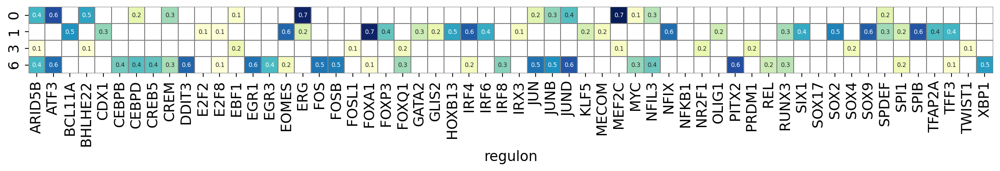

In [166]:

df_heatmap = pd.pivot_table(data=df_results[df_results.Z >= 0.1].sort_values('Z', ascending=False),
                            index='cluster', columns='regulon', values='Z')
# We leave out Myocyte because many TFs are highly enriched (becuase of small number of cells).
df_heatmap.drop(index=['7', '4', '2', '5'], inplace=True) 
fig, ax1 = plt.subplots(1, 1, figsize=(14, 12))
sns.heatmap(df_heatmap, ax=ax1, annot=True, fmt=".1f", linewidths=.9, cbar=False, square=True, linecolor='gray', 
             cmap="YlGnBu", xticklabels=True, yticklabels=True, annot_kws={"size": 6})
ax1.set_ylabel('')
savesvg('cluster_regulons.svg', fig, folder = 'human/scenic/figures')

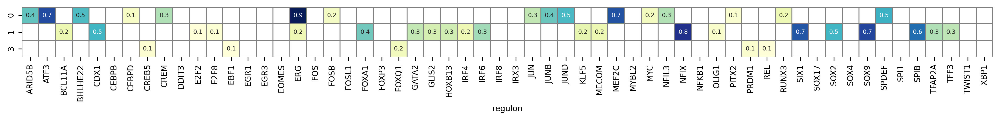

In [29]:
# ERG+
df_heatmap_ERGpos = pd.pivot_table(data=df_results_ERGpos[df_results_ERGpos.Z >= 0.1].sort_values('Z', ascending=False),
                            index='cluster', columns='regulon', values='Z')
# We leave out Myocyte because many TFs are highly enriched (becuase of small number of cells).
df_heatmap_ERGpos.drop(index=['4', '2'], inplace=True) 
fig, ax1 = plt.subplots(1, 1, figsize=(14, 12))
sns.heatmap(df_heatmap_ERGpos, ax=ax1, annot=True, fmt=".1f", linewidths=.9, cbar=False, square=True, linecolor='gray', 
             cmap="YlGnBu", xticklabels=True, yticklabels=True, annot_kws={"size": 6})
ax1.set_ylabel('')
savesvg('cluster_regulons_ERGpos.svg', fig, folder = 'human/scenic/figures')

In [167]:
## AUCELL DISTRIBUTIONS
# analyze the distribution of AUCell values via the plots in the scanpy package.
df_results.sort_values('Z', ascending=False).groupby(by='cluster').head(2)

,cluster,regulon,Z
349,5,SPIB,2.677544
287,4,SOX9,1.714390
291,4,TFAP2A,1.649546
297,5,BCL11A,1.576446
467,7,SPIB,1.388374
123,2,CEBPB,1.259839
119,2,ATF3,1.225890
35,0,MEF2C,0.743587
16,0,ERG,0.722366
79,1,FOXA1,0.721248


In [31]:
df_results_ERGpos.sort_values('Z', ascending=False).groupby(by='cluster').head(4)

,cluster,regulon,Z
270,4,MECOM,3.028029
291,4,TFAP2A,2.242857
290,4,SPIB,2.205987
275,4,NFIX,1.997752
119,2,ATF3,1.248997
123,2,CEBPB,1.242389
136,2,FOSB,1.173802
149,2,JUNB,1.157571
16,0,ERG,0.853987
98,1,NFIX,0.774438


## AUCELL + tSNE PROJECTION

In [211]:
adata_human_new = sc.read_h5ad('outs_human/h5ads/erg_fibroblasts_scvi_v6_regulons_annot_new2.h5ad', chunk_size=100000)

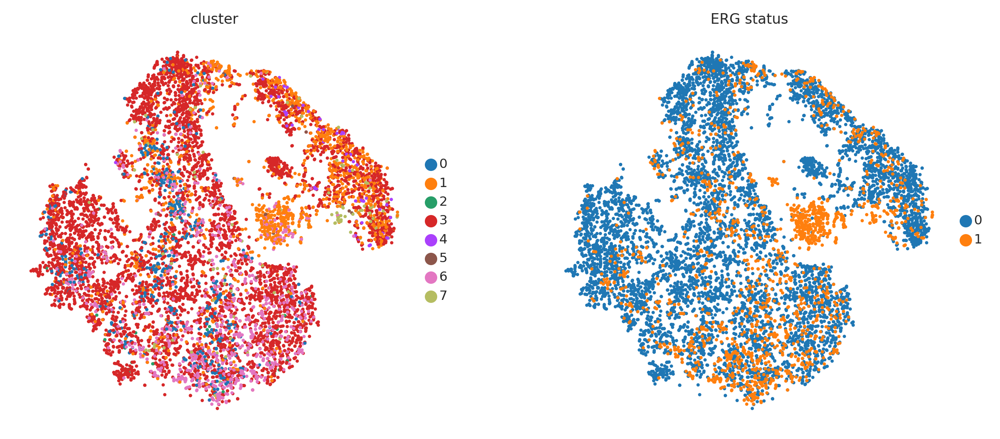

In [212]:
# all human cases
# We change the tSNE projection so that it relies on AUCell instead of PCA.
sc.pp.pca(adata_human_new)
sc.pp.neighbors(adata_human_new)
sc.tl.tsne(adata_human_new, use_rep='X_aucell')
embedding_aucell_tsne = pd.DataFrame(adata_human_new.obsm['X_tsne'], columns=[['_X', '_Y']], index=adata_human_new.obs_names)
sc.set_figure_params(frameon=False, dpi=150, fontsize=8)
sc.pl.tsne(adata_human_new, color=['cluster', 'erg'], 
           title=['cluster', 'ERG status'],
          save='tsne_AUCell.svg')


In [213]:
adata_human_new

AnnData object with n_obs × n_vars = 8628 × 1342
    obs: 'key', 'condition', 'tn', 'case', 'erg', 'n_counts', 'n_genes', 'percent_mito', 'S_score', 'G2M_score', 'phase', 'scrubletscores', 'scrubletdoublets', 'leiden', '_scvi_batch', '_scvi_labels', 'endothelial', 'fibroblast', 'myofibroblast', 'dendritic', 'pDC', 'cCDs', 'langherhans_like', 'b', 't_nk', 'myeloid', 'mast', 'luminal', 'basal', 'notbasal', 'macrophages', 'neuroendocrine', 'seminal_vesicle_basal', 'seminal_vesicle_luminal', 'seminal_vesicle_ionocyte', 'Regulon(ARID5B)', 'Regulon(ATF3)', 'Regulon(BCL11A)', 'Regulon(BHLHE22)', 'Regulon(CDX1)', 'Regulon(CEBPB)', 'Regulon(CEBPD)', 'Regulon(CREB5)', 'Regulon(CREM)', 'Regulon(DDIT3)', 'Regulon(E2F2)', 'Regulon(E2F8)', 'Regulon(EBF1)', 'Regulon(EGR1)', 'Regulon(EGR3)', 'Regulon(EOMES)', 'Regulon(ERG)', 'Regulon(FOS)', 'Regulon(FOSB)', 'Regulon(FOSL1)', 'Regulon(FOXA1)', 'Regulon(FOXP3)', 'Regulon(FOXQ1)', 'Regulon(GATA2)', 'Regulon(GLIS2)', 'Regulon(HOXB13)', 'Regulon(IRF4)', 'R

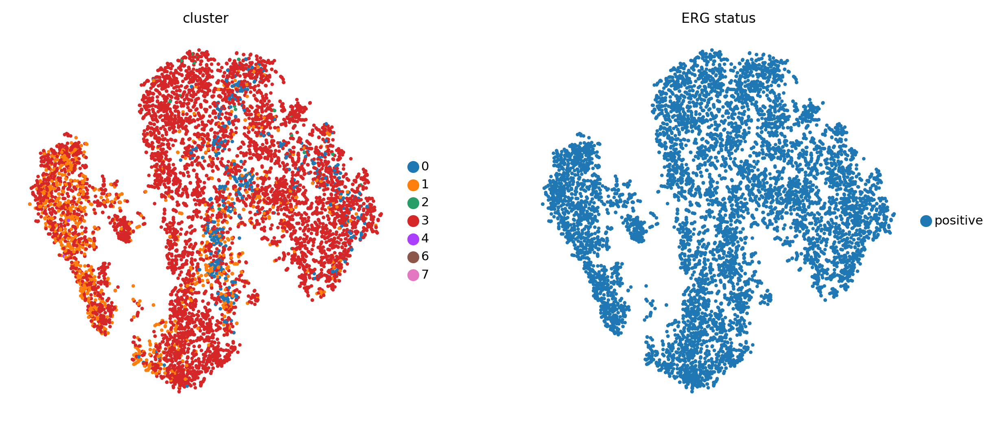

In [34]:
# ERG+
# We change the tSNE projection so that it relies on AUCell instead of PCA.
sc.pp.pca(adata_human_ERGpos)
sc.pp.neighbors(adata_human_ERGpos)
sc.tl.tsne(adata_human_ERGpos, use_rep='X_aucell')
embedding_aucell_tsne = pd.DataFrame(adata_human_ERGpos.obsm['X_tsne'], columns=[['_X', '_Y']], index=adata_human_ERGpos.obs_names)
sc.set_figure_params(frameon=False, dpi=150, fontsize=8)
sc.pl.tsne(adata_human_ERGpos, color=['cluster', 'erg'], 
           title=['cluster', 'ERG status'],
          save='tsne_AUCell_ERGpos.svg')

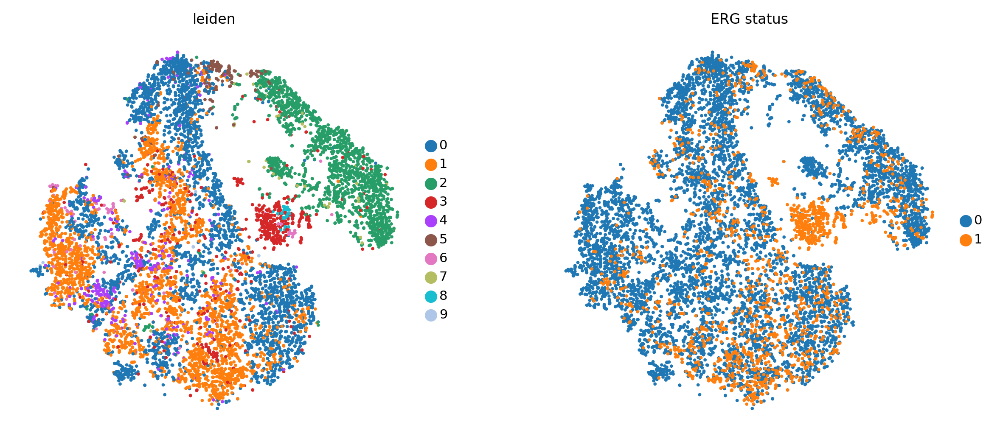

In [22]:
sc.pl.tsne(adata_human_new, color=['leiden', 'erg'], 
           title=['leiden', 'ERG status'])

In [237]:
adata_human_new = sc.read_h5ad('outs_human/h5ads/erg_fibroblasts_scvi_v6_regulons_annot_new.h5ad', chunk_size=100000)

In [238]:
#import umap

# UMAP
#runUmap = umap.UMAP(n_neighbors=10, min_dist=0.4, metric='correlation').fit_transform
#dr_umap = runUmap( auc_mtx )
#pd.DataFrame(dr_umap, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_umap.txt", sep='\t')

In [185]:
dr_umap = pd.read_csv( 'scenic_umap.txt', sep='\t', header=0, index_col=0 )

In [186]:
sc.pp.pca(adata_human_new)
sc.pp.neighbors(adata_human_new)
sc.tl.umap(adata_human_new)

In [187]:
# cell annotations from the loom column attributes:
cellAnnot = pd.concat(
    [
        pd.DataFrame( adata_human_new.obs.cluster, index=adata_human_new.obs_names ),
        pd.DataFrame( adata_human_new.obs.erg, index=adata_human_new.obs_names),
        pd.DataFrame( adata_human_new.obs.leiden, index=adata_human_new.obs_names),
        pd.DataFrame( adata_human_new.obs.percent_mito, index=adata_human_new.obs_names ),
        pd.DataFrame( adata_human_new.obs.n_genes, index=adata_human_new.obs_names )
    ],
    axis=1
)
cellAnnot.columns = [
 'cluster',
 'erg',
 'leiden',
 'Percent_mito',
 'nGene']

In [188]:
Embeddings_X = pd.DataFrame( index=adata_human_new.obs_names )
Embeddings_X = pd.concat( [
        pd.DataFrame(adata_human_new.obsm['X_umap'],index=adata_human_new.obs.index)[0] ,
        pd.DataFrame(adata_human_new.obsm['X_pca'],index=adata_human_new.obs.index)[0] ,
        dr_umap['X']
    ], sort=False, axis=1, join='outer' )
Embeddings_X.columns = ['1','2','3']

Embeddings_Y = pd.DataFrame( index=adata_human_new.obs_names )
Embeddings_Y = pd.concat( [
        pd.DataFrame(adata_human_new.obsm['X_umap'],index=adata_human_new.obs.index)[1] ,
        pd.DataFrame(adata_human_new.obsm['X_pca'],index=adata_human_new.obs.index)[1] ,
        dr_umap['Y']
    ], sort=False, axis=1, join='outer' )
Embeddings_Y.columns = ['1','2','3']

In [189]:
# capture embeddings:
dr = [
    pd.DataFrame( dfToNamedMatrix(tsneDF), index=adata_human_new.obs_names )
]
dr_names = ['tsne', 'umap', 'pca', 'aucell']

# add other embeddings
drx = pd.DataFrame(Embeddings_X, index=adata_human_new.obs_names )
dry = pd.DataFrame(Embeddings_Y, index=adata_human_new.obs_names )

for i in range( len(drx.columns) ):
    dr.append( pd.concat( [ drx.iloc[:,i], dry.iloc[:,i] ], sort=False, axis=1, join='outer' ))
    #dr_names.append( meta['embeddings'][i+1]['name'].replace(" ","_").replace('/','-') )

# rename columns:
for i,x in enumerate( dr ):
    x.columns = ['X','Y']

In [190]:
def colorMap( x, palette='bright' ):
    import natsort
    from collections import OrderedDict
    #
    n=len(set(x))
    cpalette = sns.color_palette(palette,n_colors=n )
    cdict = dict( zip( list(set(x)), cpalette ))
    cmap = [ cdict[i] for i in x ]
    cdict = OrderedDict( natsort.natsorted(cdict.items()) )
    return cmap,cdict

def drplot( dr, colorlab, ax, palette='bright', title=None, **kwargs ):
    cmap,cdict = colorMap( colorlab, palette )
    for lab,col in cdict.items():  
        ix = colorlab.loc[colorlab==lab].index
        ax.scatter( dr['X'][ix], dr['Y'][ix], c=[col]*len(ix), alpha=0.7, label=lab, edgecolors='none')
    if( title is not None ):
        ax.set_title(title, fontsize='x-large');
    #
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)

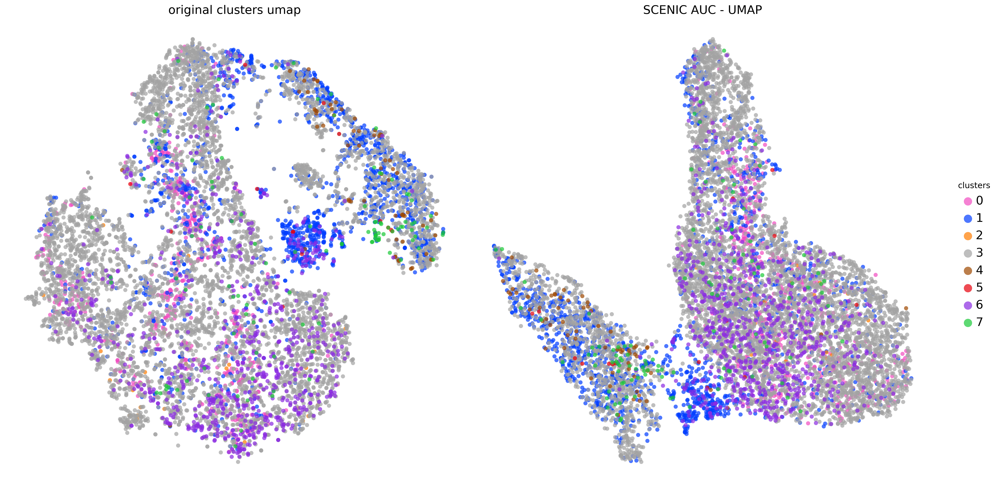

In [191]:
plt.rcParams.update({'font.size':12})

fig, (ax1,ax2) = plt.subplots(1,2, figsize=(20,10), dpi=150 )

drplot( dr[0], colorlab=cellAnnot['cluster'], ax=ax1, palette='bright', s=2, title='original clusters umap' )

drplot( dr[3], colorlab=cellAnnot['cluster'], ax=ax2, palette='bright', s=2, title='SCENIC AUC - UMAP' )
ax2.legend(loc='right', bbox_to_anchor=(1.15, 0.5), ncol=1, markerscale=2, fontsize='x-large', frameon=False, title="\nclusters")

plt.tight_layout()
plt.savefig("scenic_umap.pdf", dpi=300, bbox_inches = "tight")

## heatmaps

In [270]:
adata_human = sc.read_h5ad('outs_human/h5ads/erg_fibroblasts_scvi_v6_regulons_annot_new.h5ad', chunk_size=100000)

In [271]:
adata_human_new = adata_human.copy()
adata_human_new = adata_human_new.raw.to_adata()
adata_human_new.X = sp.csr_matrix.todense(adata_human_new.X)
adata_human_new.X = adata_human_new.to_df()

In [272]:
adata_human_new

AnnData object with n_obs × n_vars = 8628 × 30631
    obs: 'key', 'condition', 'tn', 'case', 'erg', 'n_counts', 'n_genes', 'percent_mito', 'S_score', 'G2M_score', 'phase', 'scrubletscores', 'scrubletdoublets', 'leiden', '_scvi_batch', '_scvi_labels', 'endothelial', 'fibroblast', 'myofibroblast', 'dendritic', 'pDC', 'cCDs', 'langherhans_like', 'b', 't_nk', 'myeloid', 'mast', 'luminal', 'basal', 'notbasal', 'macrophages', 'neuroendocrine', 'seminal_vesicle_basal', 'seminal_vesicle_luminal', 'seminal_vesicle_ionocyte', 'Regulon(ARID5B)', 'Regulon(ATF3)', 'Regulon(BCL11A)', 'Regulon(BHLHE22)', 'Regulon(CDX1)', 'Regulon(CEBPB)', 'Regulon(CEBPD)', 'Regulon(CREB5)', 'Regulon(CREM)', 'Regulon(DDIT3)', 'Regulon(E2F2)', 'Regulon(E2F8)', 'Regulon(EBF1)', 'Regulon(EGR1)', 'Regulon(EGR3)', 'Regulon(EOMES)', 'Regulon(ERG)', 'Regulon(FOS)', 'Regulon(FOSB)', 'Regulon(FOSL1)', 'Regulon(FOXA1)', 'Regulon(FOXP3)', 'Regulon(FOXQ1)', 'Regulon(GATA2)', 'Regulon(GLIS2)', 'Regulon(HOXB13)', 'Regulon(IRF4)', '

In [275]:
sc.pp.highly_variable_genes(adata_human_new, min_mean=0.0125, max_mean=3, min_disp=0.5)
# regress out total counts per cell and the percentage of mitochondrial genes expressed
sc.pp.regress_out(adata_human_new, ['n_counts', 'percent_mito'] ) #, n_jobs=args.threads)
# scale each gene to unit variance, clip values exceeding SD 10.
sc.pp.scale(adata_human_new, max_value=10)
sc.pp.pca(adata_human_new, use_highly_variable = True)
sc.pp.neighbors(adata_human_new)
sc.tl.umap(adata_human_new)

NameError: name 'init_pos' is not defined

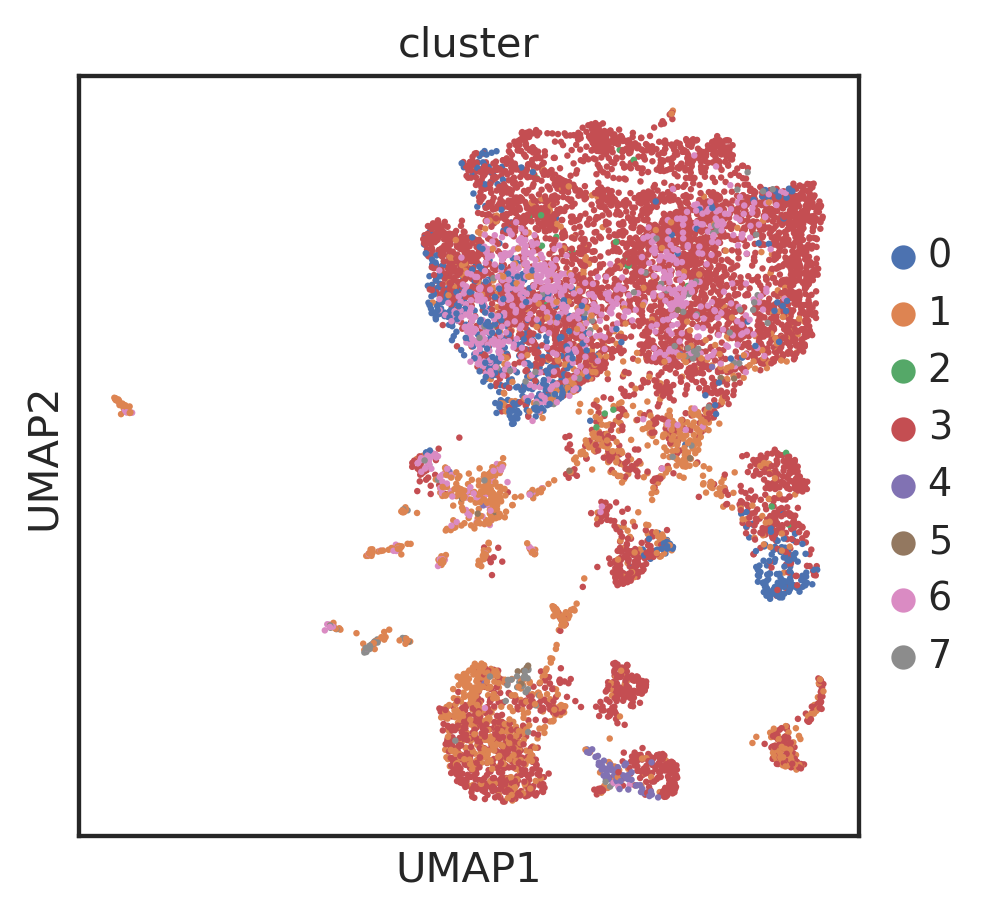

In [277]:
sc.pl.umap(adata_human_new, color='cluster')

In [241]:
# Arrange the cell annotation dataframe by the clusters
adata_human_new.obs.sort_values(by = ['cluster'], inplace=True)

# Re-arrange the cells in auc_mtx to match those in cellAnnotation
auc_mtx['CellID'] = auc_mtx.index
cell_index = pd.DataFrame(adata_human_new.obs_names)
cell_index = cell_index.rename(columns = {0:'CellID'})
auc_mtx_ord = cell_index.merge(auc_mtx, on = "CellID")
auc_mtx_ord.index = auc_mtx_ord['CellID']
del auc_mtx_ord['CellID']

In [242]:
# calc regulon specificity score
rss_cellType = regulon_specificity_scores( auc_mtx_ord, adata_human_new.obs['cluster'] )
rss_cellType

# Select the top 5 regulons from each cell type
cats = sorted(list(set(adata_human_new.obs['cluster'])))
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_cellType.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))


In [243]:
# Generate a Z-score for each regulon to enable comparison between regulons
auc_mtx_Z = pd.DataFrame( index=auc_mtx_ord.index )
for col in list(auc_mtx_ord.columns):
    auc_mtx_Z[ col ] = ( auc_mtx_ord[col] - auc_mtx_ord[col].mean()) / auc_mtx_ord[col].std(ddof=0)
#auc_mtx_Z.sort_index(inplace=True)
# Transpose
auc_mtx_Z_transposed = auc_mtx_Z.transpose()

In [244]:
# Filter to the top 10 regulons per cluster
auc_mtx_Z_top10 = auc_mtx_Z[topreg]
# Transpose
auc_mtx_Z_top10_transposed = auc_mtx_Z_top10.transpose()

In [245]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

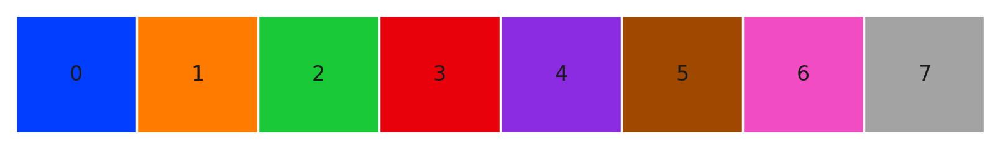

In [246]:
colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in adata_human_new.obs['cluster'] ]
sns.set()
sns.set(font_scale=0.8)
fig = palplot( colors, cats, size=1.0)
plt.savefig("human/scenic/figures/cluster_colors.svg", dpi=600, bbox_inches = "tight")

# binary heatmap

In [247]:
# Re-arrange the cells in bin_mtx to match those in cellAnnotation
bin_mtx['CellID'] = bin_mtx.index
cell_index = pd.DataFrame(adata_human_new.obs_names)
cell_index = cell_index.rename(columns = {0:'CellID'})
bin_mtx_ord = cell_index.merge(bin_mtx, on = "CellID")
bin_mtx_ord.index = bin_mtx_ord['CellID']
del bin_mtx_ord['CellID']

In [248]:
# Filter to the top 10 regulons per cluster
bin_mtx_top10 = bin_mtx_ord[topreg]
# Transpose
bin_mtx_top10_transposed = bin_mtx_top10.transpose()

In [249]:
adata_human_new.obs.cluster = adata_human_new.obs.cluster.astype('category')
adata_human_new.obs.cluster.value_counts()

3    5539
1    1476
6     789
0     607
7     113
4      63
2      25
5      16
Name: cluster, dtype: int64

In [251]:
adata_human_new.uns['cluster_colors'] = adata_mouse.uns['cluster_colors']  # fix colors

In [252]:
# binary heatmap for all regulons in all clusters
N_COLORS = len(adata_human_new.obs.cluster.dtype.categories)
COLORS = [color['color'] for color in mpl.rcParams["axes.prop_cycle"]]

cell_type_color_lut = dict(zip(adata_human_new.obs.cluster.dtype.categories, COLORS))
cell_type_color_lut = dict(zip(adata_human_new.obs.cluster.dtype.categories, adata_human_new.uns['cluster_colors']))
#cell_id2cell_type_lut = anndata.var.set_index('cell_id').cell_type.to_dict()
bw_palette = sns.xkcd_palette(["white", "black"])

sns.set()
sns.set(font_scale=1.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(bin_mtx_ord.T,
                col_colors=bin_mtx_ord.index.map(adata_human_new.obs['cluster'].to_dict()).map(cell_type_color_lut),
                yticklabels=True, col_cluster = False,
                cmap=bw_palette, figsize=(50,75))

# for the legend
for cluster in cats:
    g.ax_col_dendrogram.bar(0, 0, color=colorsd[cluster],
                            label=cluster, linewidth=0.5)
g.ax_col_dendrogram.legend(loc="center", ncol=9, bbox_transform=gcf().transFigure, fontsize = 60)
col = g.ax_col_dendrogram.get_position()
g.ax_col_dendrogram.set_position([col.x0+0.03, col.y0+0.03, col.width*1.0, col.height*0.2])

g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 30, fontweight = 'medium')
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Type'])
g.cax.set_visible(False)
g.ax_col_dendrogram.set_visible(True)
g.ax_row_dendrogram.set_visible(False)
plt.tight_layout()
g.fig.savefig(os.path.join('human/scenic/figures', 'scenic_human_binary.png'), dpi=200, format='png')

/pbtech_mounts/homes064/mao4005/.conda/envs/pathml/lib/python3.8/site-packages/seaborn/matrix.py:649: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


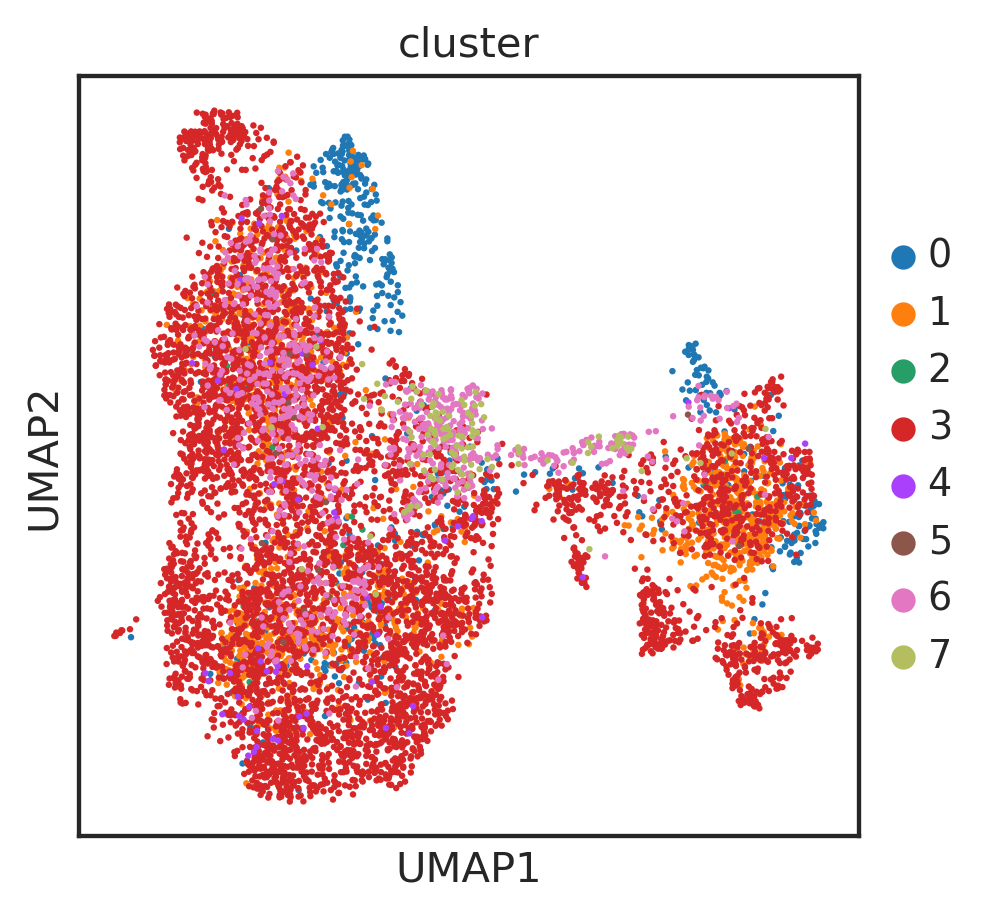

In [254]:
sc.pl.umap(adata_human_new, color='cluster')

In [216]:
df_obs = adata_human_new.obs
signature_column_names = list(df_obs.select_dtypes('number').columns)
signature_column_names = list(filter(lambda s: s.startswith('Regulon('), signature_column_names))
sc.set_figure_params(dpi=125, dpi_save=125, figsize=(4,4))
sc.pl.umap(adata_human_new, color=signature_column_names, cmap='Reds', size=8)

##################

In [225]:
colors = sns.color_palette('bright',n_colors=len(adata_human_new.obs.cluster) )

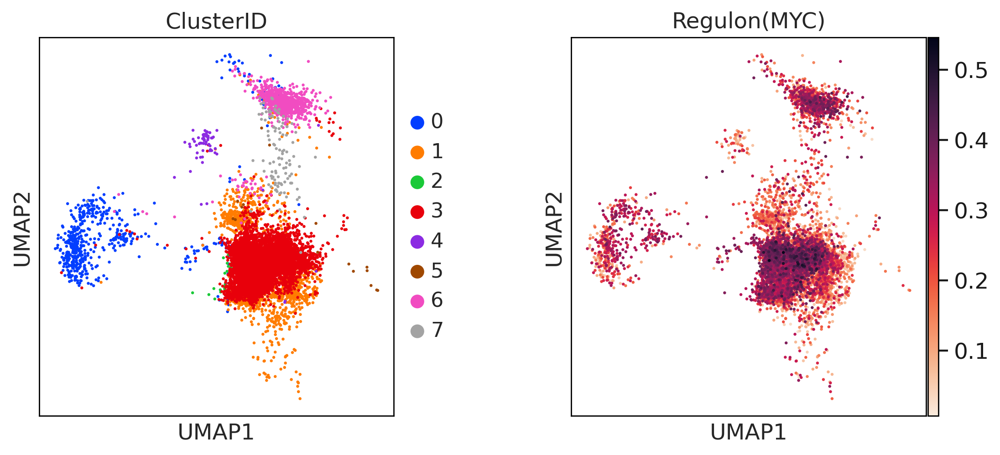

In [236]:
sc.pl.scatter(adata_human_new, basis='umap', color=['cluster', 'Regulon(MYC)'], 
        title=['ClusterID', 'Regulon(MYC)'], use_raw=True, palette = colors, color_map = 'rocket_r')